# Figure 2 Ye et al. 2023

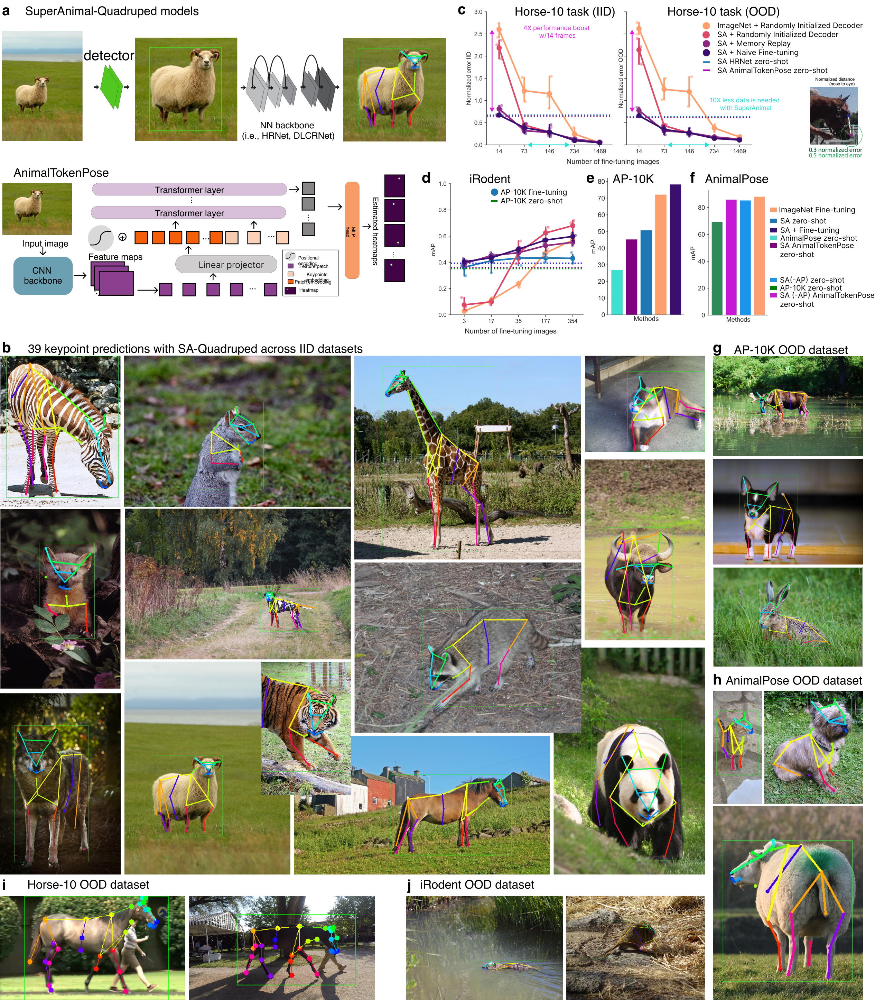

In [1]:
import matplotlib.pyplot as plt
import glob
import os
import sys
import matplotlib.image as mpimg
import seaborn as sns
import pandas as pd
import numpy as np
import json
import sys
import copy
import cv2
import matplotlib.patches as patches


plt.rcParams['axes.labelsize'] = 17  # for x and y labels
plt.rcParams['xtick.labelsize'] = 17 # for x axis tick labels
plt.rcParams['ytick.labelsize'] = 17 # for y axis tick labels
plt.rcParams['axes.titlesize'] = 17




## Load and plot raw images from IID dataset:

In [2]:

quadruped_iid_files = glob.glob('../data/Figure2/iid/*.jpg')
quadruped_iid_files = sorted(quadruped_iid_files)

quadruped_pred_iid_files = glob.glob('../data/Figure2/pred_iid/*.jpg')
quadruped_pred_iid_files = sorted(quadruped_pred_iid_files)


quadruped_ood_files = glob.glob('../data/Figure2/ap10k/*.jpg')
quadruped_ood_files = sorted(quadruped_ood_files)


quadruped_pred_ood_files = glob.glob('../data/Figure2/pred_ap10k/*.jpg')
quadruped_pred_ood_files = sorted(quadruped_pred_ood_files)


horse30_ood_files = glob.glob('../data/Figure2/horse30/*.png')
horse30_ood_files = sorted(horse30_ood_files)


horse30_pred_ood_files = glob.glob('../data/Figure2/pred_horse30/*.png')
horse30_pred_ood_files = sorted(horse30_pred_ood_files)


rodent_ood_files = glob.glob('../data/Figure2/rodent/*.jpg')
rodent_ood_files = sorted(rodent_ood_files)


rodent_pred_ood_files = glob.glob('../data/Figure2/pred_rodent/*.jpg')
rodent_pred_ood_files = sorted(rodent_pred_ood_files)



animalpose_ood_files = glob.glob('../data/Figure2/animalpose/*.jpg')
animalpose_ood_files = sorted(animalpose_ood_files)


animalpose_pred_ood_files = glob.glob('../data/Figure2/pred_animalpose/*.jpg')
animalpose_pred_ood_files = sorted(animalpose_pred_ood_files)




['../data/Figure2/animalpose/2010_001705.jpg', '../data/Figure2/animalpose/2010_003937.jpg', '../data/Figure2/animalpose/2010_005285.jpg']


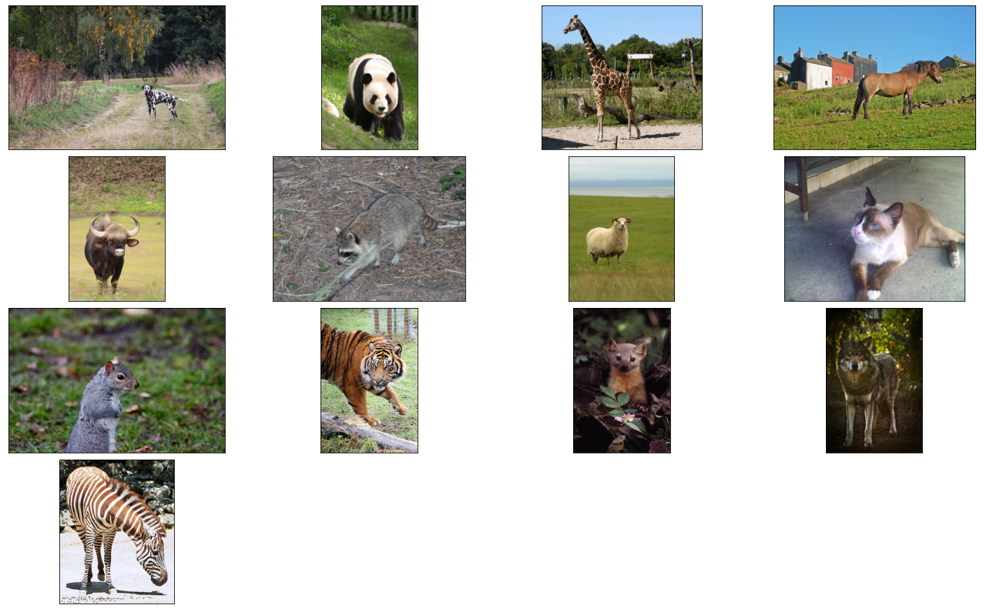

In [3]:
fig, axes = plt.subplots(4,4)

for idx in range(16):
    row = idx //4
    col = idx % 4
    
    if idx > 12:
        axes[row][col].axis('off')
        continue    
    
    file = quadruped_iid_files[idx]
    img =  mpimg.imread(file)    
    axes[row][col].imshow(img)
    axes[row][col].set_xticks([])
    axes[row][col].set_yticks([])                

plt.subplots_adjust(left=0.05, right=0.95, bottom=0.05, top=0.95, wspace=0.05, hspace=0.05)
fig.set_size_inches(20, 12) 
plt.show()

In [327]:
import cv2
import numpy as np
import json

def plot_keypoints_and_bbox(image_file, json_file, kpt_thr=0.6, kpt_width=3, skeleton_width=1):
    # Read the JSON file for dataset information
    with open('../data/superquadruped_dataset.json') as f:
        dataset_info = json.load(f)
        keypoint_info = dataset_info['dataset_info']['keypoint_info']
        skeleton_info = dataset_info['dataset_info']['skeleton_info']


        
    # Create a dictionary for keypoint names to IDs and colors
    kpt_name_2_id = {v['name']: v['id'] for k, v in keypoint_info.items()}
    kpt_colors = [v['color'] for k, v in keypoint_info.items()]

    # Prepare color pairs for skeleton links
    n_kpts = 39
    pair_2_color = np.ones((n_kpts, n_kpts, 3), dtype=np.uint8) * 255  # Default to white
    for skeleton_id, skeleton in skeleton_info.items():
        if 'antler' in skeleton['link'][0] or 'antler' in skeleton['link'][1]:
            continue
        p1, p2 = kpt_name_2_id[skeleton['link'][0]], kpt_name_2_id[skeleton['link'][1]]
        
        color = skeleton['color']
        pair_2_color[p1][p2] = color
        pair_2_color[p2][p1] = color

    # Read keypoints and bbox from the provided JSON file
    with open(json_file, 'r') as f:
        obj = json.load(f)
        keypoints = np.array(obj[0]['keypoints'])
        bbox = np.array(obj[0]['bbox'])[:4]

    # Read and prepare the image
    img = cv2.imread(image_file)
    
    # Draw bounding box
    cv2.rectangle(img, (int(bbox[0]), int(bbox[1])), (int(bbox[2]), int(bbox[3])), (0, 255, 0), 2)

    # Draw keypoints
    for idx, kpt in enumerate(keypoints):
        if kpt[2] > kpt_thr:
            cv2.circle(img, (int(kpt[0]), int(kpt[1])), kpt_width, kpt_colors[idx], -1)

    # Draw skeleton
    for i in range(n_kpts):
        for j in range(n_kpts):
            if i != j and not np.all(pair_2_color[i][j] == 255):  # Check if the color is not default white
                if keypoints[i][2] >= kpt_thr and keypoints[j][2] >= kpt_thr:
                    cv2.line(img, (int(keypoints[i][0]), int(keypoints[i][1])), 
                             (int(keypoints[j][0]), int(keypoints[j][1])), 
                             pair_2_color[i][j].tolist(), skeleton_width)

    # Save the result image
    title = 'pred_' + image_file.split('/')[-1]
    cv2.imwrite(title, img)
    return img




# Plot the SuperAnimal-Quadruped IID keypoints:

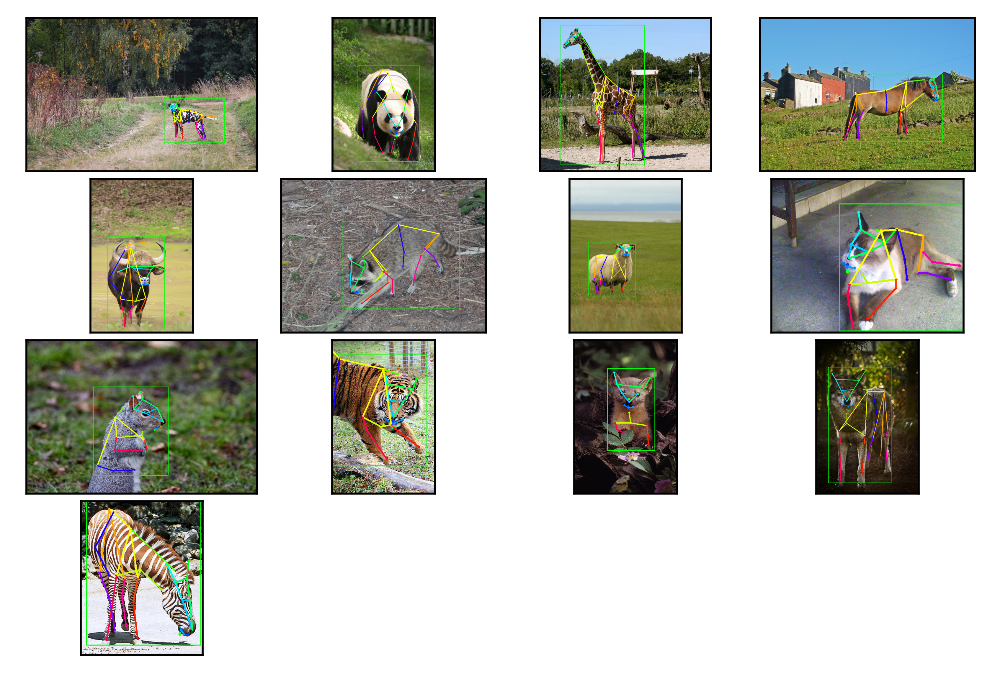

In [341]:
fig, axes = plt.subplots(4,4, dpi=600)

for idx in range(16):
    row = idx //4
    col = idx % 4
    
    if idx > 12:
        axes[row][col].axis('off')
        continue    
    
    image_file = quadruped_iid_files[idx]
    
    parent = '/'.join(image_file.split('/')[:-1])
    imagefilename = image_file.split('/')[-1]
    json_file = os.path.join(parent, 'pred_result_' + imagefilename.replace('vis_', '') + '.json')
    axes[row][col].set_xticks([])
    axes[row][col].set_yticks([])
    img = plot_keypoints_and_bbox(image_file, json_file, kpt_width = 4,
                            skeleton_width = 3, kpt_thr = 0.3)
    
    axes[row][col].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                

plt.subplots_adjust(left=0.05, right=0.95, bottom=0.05, top=0.95, wspace=0.05, hspace=0.05)

plt.show()


# Plot the SuperAnimal-Quadruped AP-10K OOD raw data and keypoints:

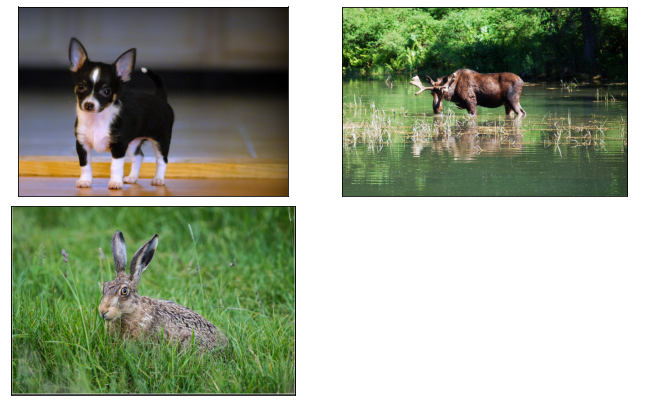

In [282]:
fig, axes = plt.subplots(2,2)

for idx in range(4):
    row = idx //2
    col = idx % 2
    
    if idx > 2:
        axes[row][col].axis('off')
        continue    
    
    file = quadruped_ood_files[idx]
    img =  mpimg.imread(file)    
    axes[row][col].imshow(img)
    axes[row][col].set_xticks([])
    axes[row][col].set_yticks([])                

fig.set_size_inches(10, 6) 
plt.subplots_adjust(left=0.05, right=0.95, bottom=0.05, top=0.95, wspace=0.05, hspace=0.05)
plt.show()

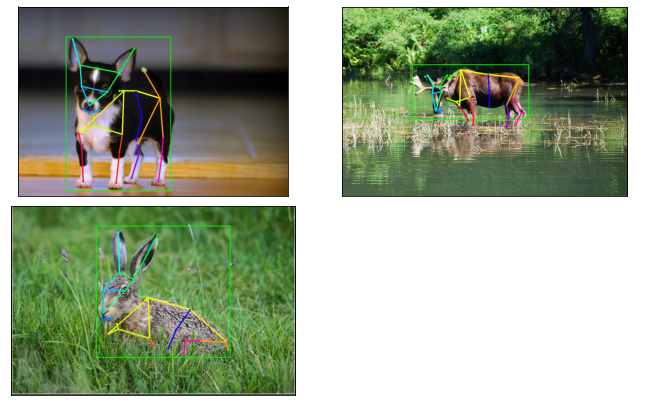

In [342]:
fig, axes = plt.subplots(2,2)

for idx in range(4):
    row = idx //2
    col = idx % 2
    
    if idx > 2:
        axes[row][col].axis('off')
        continue    
    image_file = quadruped_ood_files[idx]
    
    parent = '/'.join(image_file.split('/')[:-1])
    imagefilename = image_file.split('/')[-1]
    json_file = os.path.join(parent, 'pred_result_' + imagefilename.replace('vis_', '') + '.json')
    img = plot_keypoints_and_bbox(image_file, json_file,   kpt_width = 4,
                            skeleton_width = 3, kpt_thr = 0.3)
    axes[row][col].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    
    
    axes[row][col].set_xticks([])
    axes[row][col].set_yticks([])                

fig.set_size_inches(10, 6) 
plt.subplots_adjust(left=0.05, right=0.95, bottom=0.05, top=0.95, wspace=0.05, hspace=0.05)
plt.show()

# Plot the SuperAnimal-Quadruped Animalpose OOD raw data:


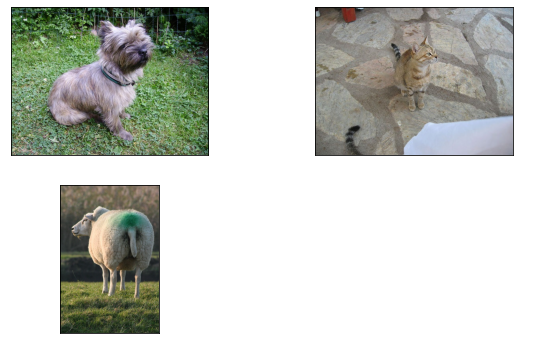

In [257]:
fig, axes = plt.subplots(2,2)

for idx in range(4):
    row = idx //2
    col = idx % 2
    if idx > 2:
        axes[row][col].axis('off')
        continue    
    
    file = animalpose_ood_files[idx]
    img =  mpimg.imread(file)    
    axes[row][col].imshow(img)
    axes[row][col].set_xticks([])
    axes[row][col].set_yticks([])                

fig.set_size_inches(10, 6) 
plt.show()

# Plot the SuperAnimal-Quadruped Animalpose OOD keypoints:


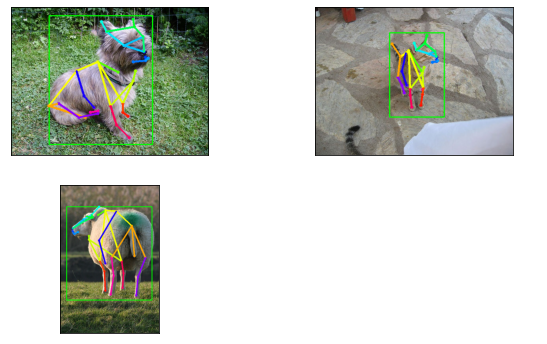

In [344]:
fig, axes = plt.subplots(2,2)

for idx in range(4):
    row = idx //2
    col = idx % 2
    if idx > 2:
        axes[row][col].axis('off')
        continue    
    
    image_file = animalpose_ood_files[idx]
    
    parent = '/'.join(image_file.split('/')[:-1])
    imagefilename = image_file.split('/')[-1]
    json_file = os.path.join(parent, 'pred_result_' + imagefilename.replace('vis_', '') + '.json')
    img = plot_keypoints_and_bbox(image_file, json_file,   kpt_width = 4, kpt_thr = 0.3,
                            skeleton_width = 3)
    axes[row][col].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[row][col].set_xticks([])
    axes[row][col].set_yticks([])                

fig.set_size_inches(10, 6) 
plt.show()

# Plot the SuperAnimal-Quadruped iRodent OOD raw data:


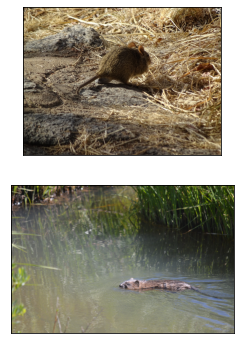

In [259]:
fig, axes = plt.subplots(2)

for idx in range(2):    
    
    file = rodent_ood_files[idx]
    img =  mpimg.imread(file)    
    axes[idx].imshow(img)
    axes[idx].set_xticks([])
    axes[idx].set_yticks([])                

fig.set_size_inches(10, 6) 
plt.show()

# Plot the SuperAnimal-Quadruped iRodent OOD keypoints:


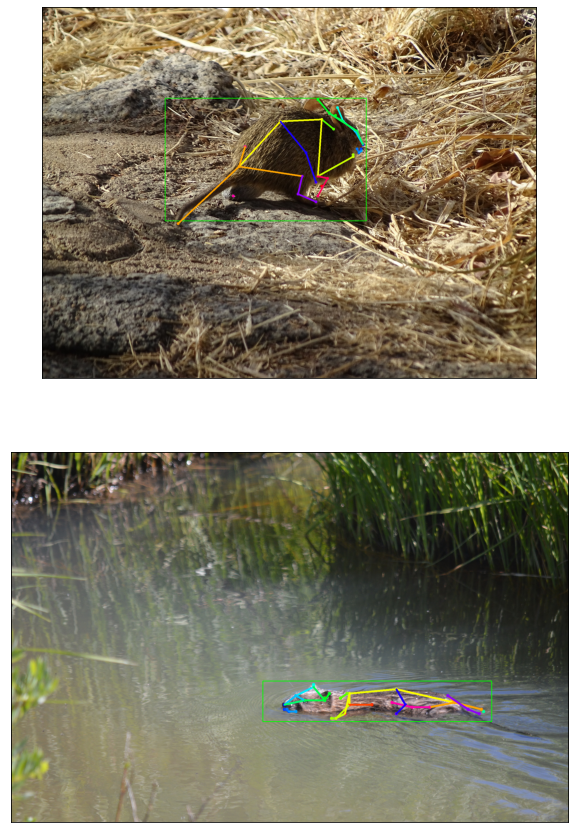

In [345]:
fig, axes = plt.subplots(2)

for idx in range(2):    

    image_file = rodent_ood_files[idx]
    parent = '/'.join(image_file.split('/')[:-1])
    imagefilename = image_file.split('/')[-1]
    json_file = os.path.join(parent, 'pred_result_' + imagefilename.replace('vis_', '') + '.json')
    img = plot_keypoints_and_bbox(image_file, json_file,   kpt_width = 6, kpt_thr = 0.3,
                            skeleton_width = 6)
    axes[idx].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[idx].set_xticks([])
    axes[idx].set_yticks([])                

fig.set_size_inches(15, 15) 
plt.show()

# Plot the SuperAnimal-Quadruped Horse-30 OOD raw data:


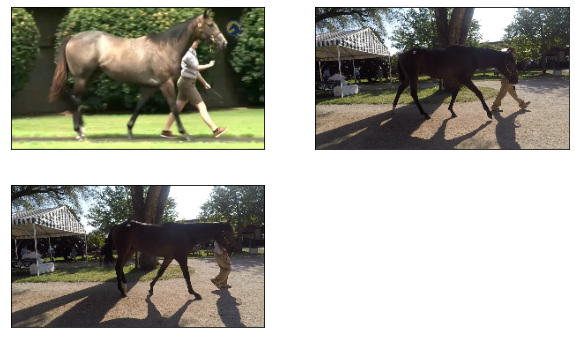

In [261]:
fig, axes = plt.subplots(2,2)

for idx in range(4):
    row = idx //2
    col = idx % 2
    if idx > 2:
        axes[row][col].axis('off')
        continue    
    
    file = horse30_ood_files[idx]
    img =  mpimg.imread(file)    
    axes[row][col].imshow(img)
    
    axes[row][col].set_xticks([])
    axes[row][col].set_yticks([])                

fig.set_size_inches(10, 6) 
plt.show()

# Plot the SuperAnimal-Quadruped Horse-30 OOD keypoints:


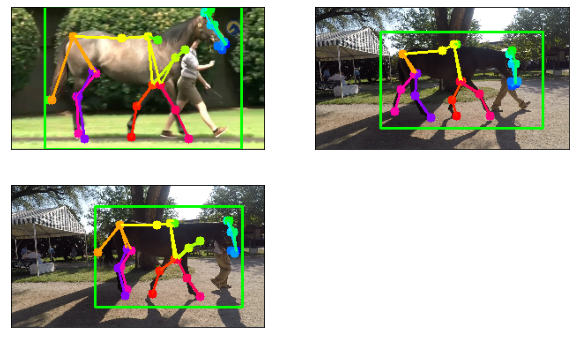

In [355]:
fig, axes = plt.subplots(2,2)

for idx in range(4):
    row = idx //2
    col = idx % 2
    if idx > 2:
        axes[row][col].axis('off')
        continue    
    
    image_file = horse30_ood_files[idx]
    parent = '/'.join(image_file.split('/')[:-1])
    imagefilename = image_file.split('/')[-1]
    json_file = os.path.join(parent, 'pred_result_' + imagefilename.replace('vis_', '') + '.json')
    img = plot_keypoints_and_bbox(image_file, json_file,   kpt_width = 5, kpt_thr = 0.2,
                            skeleton_width = 2)
    axes[row][col].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[row][col].set_xticks([])
    axes[row][col].set_yticks([])                

fig.set_size_inches(10, 6) 
plt.show()

## Plot the results of SuperAnimal-Quadruped HRNet-w32 on Horse-10 benchmark:

/var/folders/n5/5_x4w2px2wn6hc6n_9zzlygw0000gn/T/ipykernel_84943/280643653.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_masked['method'] = df_masked['pretrain_model'] + '-' + df_masked['method']


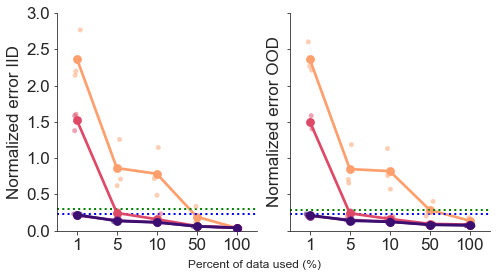

In [3]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
sns.set_style("ticks")

dataset_size = 1469


df = pd.read_csv('../data/Figure2/results/horse10.csv')

df = df.iloc[:, 1:]

df.columns = ['method', 'pretrain_model', 'training_ratio', 'shuffle', 'mAP', 'NE_iid', 'NE_ood', 'rmse']


superanimal_zeroshot_NE_iid = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'SuperAnimal') &
                  (df['training_ratio'] == 1.0)]['NE_iid']

superanimal_zeroshot_NE_ood = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'SuperAnimal') &
                  (df['training_ratio'] == 1.0)]['NE_ood']


ap10k_zeroshot_NE_iid = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'AP10k') &
                  (df['training_ratio'] == 1.0)]['NE_iid']


ap10k_zeroshot_NE_ood = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'AP10k') &
                  (df['training_ratio'] == 1.0)]['NE_ood']


df_masked = df[df['method']!='zeroshot']


df_masked['method'] = df_masked['pretrain_model'] + '-' + df_masked['method']



custom_order = ["ImageNet-transfer-learning",
                "SuperAnimal-transfer-learning",
                "SuperAnimal-memory-replay",
                "SuperAnimal-finetune"]
                


rename_dict = {'ImageNet-transfer-learning': 'HRNetw32 + ImageNet transfer learning',
               'SuperAnimal-zeroshot': 'SA + HRNetw32 + Zeroshot',
               'animaltokenpose_zeroshot' : 'SA + AnimalTokenPose + Zeroshot',
               'SuperAnimal-transfer-learning': 'HRNetw32 + SA + Randomly Initialized Decoder',          
               'SuperAnimal-memory-replay': 'HRNetw32 + SA + Memory Replay',
               'SuperAnimal-finetune': 'HRNetw32 + SA + Naive Fine-tuning'}


df_masked.set_index('method', inplace=True)

df_masked = df_masked.loc[custom_order]

df_masked.rename(index=rename_dict, inplace=True)

df_masked['training_ratio'] = (pd.to_numeric(df_masked['training_ratio']) * 100).astype(int)


df_masked = df_masked.reset_index()

# Remove the old 'pretrain_model' and 'method' columns
df_masked = df_masked.drop(['pretrain_model'], axis=1)

fig, (ax1, ax2) = plt.subplots(
    ncols=2,
    tight_layout=True,
    figsize=(7, 4),
    sharex=True,
    sharey=True,
)


NE_iid_min = np.min(superanimal_zeroshot_NE_iid)
NE_iid_max = np.max(superanimal_zeroshot_NE_iid)
#ax1.axhspan(NE_iid_min, NE_iid_max, facecolor='grey', alpha=0.5)
NE_ood_min = np.min(superanimal_zeroshot_NE_ood)
NE_ood_max = np.max(superanimal_zeroshot_NE_ood)

#ax2.axhspan(NE_ood_min, NE_ood_max, facecolor='grey', alpha=0.5)

ax1.axhline(superanimal_zeroshot_NE_iid.mean(), ls=':', lw=2, color = 'blue')


ax2.axhline(superanimal_zeroshot_NE_ood.mean(), ls=':', lw=2, color = 'blue')

ax1.axhline(ap10k_zeroshot_NE_iid.mean(), ls=':', lw=2, color = 'green')
ax2.axhline(ap10k_zeroshot_NE_ood.mean(), ls=':', lw=2, color = 'green')


#ax2.axhline(animaltokenpose_zeroshot['NE_ood'].mean(), ls=':', lw=2, color = 'purple')

pal = 'magma_r'
sns.pointplot(data=df_masked, x="training_ratio", y="NE_iid", ax=ax1, hue='method', palette=pal, errorbar=None)
sns.stripplot(data=df_masked, x="training_ratio", y="NE_iid", ax=ax1, hue='method', palette=pal, alpha = .5)

sns.pointplot(data=df_masked, x="training_ratio", y="NE_ood", ax=ax2, hue='method', palette=pal, errorbar=None)
sns.stripplot(data=df_masked, x="training_ratio", y="NE_ood", ax=ax2, hue='method', palette=pal, alpha = .5)

ax1.legend().remove()
ax2.legend().remove()


ax1.set_xlabel('')
ax1.set_ylabel('Normalized error IID')
ax1.set_ylim(0, 3.0)
ax2.set_xlabel('')
ax2.set_ylabel('Normalized error OOD')
sns.despine(top=True, right=True, ax=ax1)
sns.despine(top=True, right=True, ax=ax2)
fig.supxlabel('Percent of data used (%)', y=0.05, x=0.5125)

fig.savefig('topdown_horse_complicate.png', dpi=800, bbox_inches='tight', pad_inches=0.05, transparent = True)


/var/folders/n5/5_x4w2px2wn6hc6n_9zzlygw0000gn/T/ipykernel_79503/850838917.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_masked['method'] = df_masked['pretrain_model'] + '-' + df_masked['method']


0.2247616410570609 0.2304740361655757
0.2834499713736514 0.2935024250879926


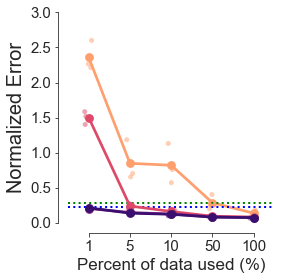

In [11]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
sns.set_style("ticks")

dataset_size = 1469



df = pd.read_csv('../data/Figure2/results/horse10.csv')

df = df.iloc[:, 1:]

df.columns = ['method', 'pretrain_model', 'training_ratio', 'shuffle', 'mAP', 'NE_iid', 'NE_ood', 'rmse']




superanimal_zeroshot_NE_iid = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'SuperAnimal') &
                  (df['training_ratio'] == 1.0)]['NE_iid']

superanimal_zeroshot_NE_ood = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'SuperAnimal') &
                  (df['training_ratio'] == 1.0)]['NE_ood']


ap10k_zeroshot_NE_iid = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'AP10k') &
                  (df['training_ratio'] == 1.0)]['NE_iid']


ap10k_zeroshot_NE_ood = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'AP10k') &
                  (df['training_ratio'] == 1.0)]['NE_ood']


df_masked = df[df['method']!='zeroshot']


df_masked['method'] = df_masked['pretrain_model'] + '-' + df_masked['method']




custom_order = ["ImageNet-transfer-learning",
                "SuperAnimal-transfer-learning",
                "SuperAnimal-memory-replay",
                "SuperAnimal-finetune"]            




rename_dict = {'ImageNet-transfer-learning': 'HRNetw32 + ImageNet transfer learning',
               'SuperAnimal-zeroshot': 'SA + HRNetw32 + Zeroshot',
               'animaltokenpose_zeroshot' : 'SA + AnimalTokenPose + Zeroshot',
               'SuperAnimal-transfer-learning': 'HRNetw32 + SA + Randomly Initialized Decoder',          
               'SuperAnimal-memory-replay': 'HRNetw32 + SA + Memory Replay',
               'SuperAnimal-finetune': 'HRNetw32 + SA + Naive Fine-tuning'}




df_masked.set_index('method', inplace=True)

df_masked = df_masked.loc[custom_order]

df_masked.rename(index=rename_dict, inplace=True)

df_masked['training_ratio'] = (pd.to_numeric(df_masked['training_ratio']) * 100).astype(int)

df_masked = df_masked.reset_index()

# Remove the old 'pretrain_model' and 'method' columns
df_masked = df_masked.drop(['pretrain_model'], axis=1)

fig, ax = plt.subplots(
    ncols=1,
    tight_layout=True,
    figsize=(4, 4),
    sharex=True,
    sharey=True,
)


superanimal_NE_ood_min = np.min(superanimal_zeroshot_NE_ood)
superanimal_NE_ood_max = np.max(superanimal_zeroshot_NE_ood)


ap10k_zeroshot_NE_ood_min = np.min(ap10k_zeroshot_NE_ood)
ap10k_zeroshot_NE_ood_max = np.max(ap10k_zeroshot_NE_ood)


ax.axhspan(superanimal_NE_ood_min, superanimal_NE_ood_max, facecolor='lightblue', alpha=0.9, hatch='//')

ax.axhspan(ap10k_zeroshot_NE_ood_min, ap10k_zeroshot_NE_ood_max, facecolor='lightgreen', alpha=0.9)

ax.axhline(superanimal_zeroshot_NE_ood.mean(), ls=':', lw=2, color = 'blue')

ax.axhline(ap10k_zeroshot_NE_ood.mean(), ls=':', lw=2, color = 'green')


pal = 'magma_r'

color_mapping = {
    "HRNetw32 + ImageNet transfer learning": "#FE9F6D",  # Map "A" to the first color in the palette   
    "HRNetw32 + SA + Memory Replay": sns.color_palette(pal)[3]   # Map "D" to the fourth color in the palette
}


sns.pointplot(data=df_masked, x="training_ratio", y="NE_ood", ax=ax, hue='method', palette=pal, errorbar=None)
sns.stripplot(data=df_masked, x="training_ratio", y="NE_ood", ax=ax, hue='method', palette=pal, alpha = .5)

ax.legend().remove()


unique_ratios = df_masked['training_ratio'].unique()
new_ticks = [df_masked[df_masked['training_ratio'] == val].index[0] for val in unique_ratios]


tick_distance = ax.get_xticks()[1] - ax.get_xticks()[0]

offset = 0.03

new_tick_positions = ax.get_xticks() + offset

ax.set_xlabel('Percent of data used (%)')
ax.set_ylim(0, 3.0)


plt.ylabel("Normalized Error", fontsize=20)

ax.tick_params(axis="both", which="major", labelsize=15)
ax.tick_params(axis = 'x')
sns.despine(
    left=False,
    right=True,
    bottom=False,
    top=True,
    trim=True,
    offset={"bottom": 10, "left": 10},
)



fig.savefig('topdown_horse_complicate.png', dpi=800, bbox_inches='tight', pad_inches=0.05, transparent = True)

## Plot the results of SuperAnimal-Quadruped HRNet-w32 on iRodent:

/var/folders/n5/5_x4w2px2wn6hc6n_9zzlygw0000gn/T/ipykernel_79503/3539334870.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_masked['method'] = df_masked['pretrain_model'] + '-' + df_masked['method']


38.928692414556295 42.92712012624118


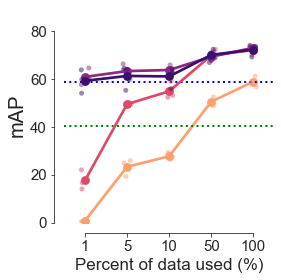

In [15]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
sns.set_style("ticks")

dataset_size = 354



df = pd.read_csv('../data/Figure2/results/rodent.csv')

df = df.iloc[:, 1:]


df.columns = ['method', 'pretrain_model', 'training_ratio', 'shuffle', 'mAP',  'rmse']

df['mAP'] = df['mAP'] * 100


superanimal_zeroshot_mAP = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'SuperAnimal') &
                  (df['training_ratio'] == 1.0)]['mAP']



ap10k_zeroshot_mAP = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'AP10k') &
                  (df['training_ratio'] == 1.0)]['mAP']

df_masked = df[df['method']!='zeroshot']


df_masked['method'] = df_masked['pretrain_model'] + '-' + df_masked['method']



custom_order = ["ImageNet-transfer-learning",
                "SuperAnimal-transfer-learning",
                "SuperAnimal-memory-replay",
                "SuperAnimal-finetune"]
                


rename_dict = {'ImageNet-transfer-learning': 'HRNetw32 + ImageNet transfer learning',
               'SuperAnimal-zeroshot': 'SA + HRNetw32 + Zeroshot',
               'animaltokenpose_zeroshot' : 'SA + AnimalTokenPose + Zeroshot',
               'SuperAnimal-transfer-learning': 'HRNetw32 + SA + Randomly Initialized Decoder',          
               'SuperAnimal-memory-replay': 'HRNetw32 + SA + Memory Replay',
               'SuperAnimal-finetune': 'HRNetw32 + SA + Naive Fine-tuning'}


df_masked.set_index('method', inplace=True)

df_masked = df_masked.loc[custom_order]

df_masked.rename(index=rename_dict, inplace=True)

df_masked = df_masked.reset_index()

#print (df_masked)

# Remove the old 'pretrain_model' and 'method' columns
df_masked = df_masked.drop(['pretrain_model'], axis=1)

df_masked['training_ratio'] = (pd.to_numeric(df_masked['training_ratio']) * 100).astype(int)

fig, ax1 = plt.subplots(
    ncols=1,
    tight_layout=True,
    figsize=(4, 4),
    sharex=True,
    sharey=True,
)



superanimal_zeroshot_mAP_min = np.min(superanimal_zeroshot_mAP)
superanimal_zeroshot_mAP_max = np.max(superanimal_zeroshot_mAP)


ap10k_zeroshot_mAP_min = np.min(ap10k_zeroshot_mAP)
ap10k_zeroshot_mAP_max = np.max(ap10k_zeroshot_mAP)


ax.axhspan(superanimal_zeroshot_mAP_min, superanimal_zeroshot_mAP_max, facecolor='lightblue', alpha=0.9, hatch='//')

ax.axhspan(ap10k_zeroshot_mAP_min, ap10k_zeroshot_mAP_max, facecolor='lightgreen', alpha=0.9)

ax1.axhline(superanimal_zeroshot_mAP.mean(), ls=':', lw=2, color = 'blue')

ax1.axhline(ap10k_zeroshot_mAP.mean(), ls=':', lw=2, color = 'green')

print (ap10k_zeroshot_mAP_min,ap10k_zeroshot_mAP_max )

pal = 'magma_r'
sns.pointplot(data=df_masked, x="training_ratio", y="mAP", ax=ax1, hue='method', palette=pal, errorbar=None)
sns.stripplot(data=df_masked, x="training_ratio", y="mAP", ax=ax1, hue='method', palette=pal, alpha = .5)


ax1.legend().remove()

ax1.set_xlabel('')

plt.ylabel("mAP", fontsize=20)

ax1.set_ylim(0, 90)

ax1.tick_params(axis="both", which="major", labelsize=15)
ax1.tick_params(axis = 'x')
sns.despine(
    left=False,
    right=True,
    bottom=False,
    top=True,
    trim=True,
    offset={"bottom": 10, "left": 10},
)


ax1.set_xlabel('Percent of data used (%)')
fig.savefig('topdown_rodent_complicate.png', dpi=800, bbox_inches='tight', pad_inches=0.05, transparent = True)

## Plot the results of SuperAnimal-Quadruped HRNet-w32 on AnimalPose

              method pretrain_model  training_ratio   shuffle       mAP  \
0           finetune          AP10k             1.0  shuffle1  0.867944   
1           finetune    SuperAnimal             1.0  shuffle1  0.868515   
2      memory-replay    SuperAnimal             1.0  shuffle1  0.870335   
3  transfer-learning          AP10k             1.0  shuffle1  0.894019   
4  transfer-learning       ImageNet             1.0  shuffle1  0.868645   
5  transfer-learning    SuperAnimal             1.0  shuffle1  0.896117   
6           zeroshot          AP10k             1.0  shuffle1  0.794473   
7           zeroshot    SuperAnimal             1.0  shuffle1  0.846390   

       rmse  
0  4.859942  
1  4.706207  
2  4.635638  
3  5.274693  
4  5.756907  
5  5.184971  
6  5.774265  
7  4.883620  


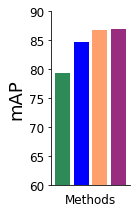

In [10]:
import matplotlib.pyplot as plt


df = pd.read_csv('../data/Figure2/results/animalpose.csv')


df = df.iloc[:, 1:]

df.columns = ['method', 'pretrain_model', 'training_ratio', 'shuffle', 'mAP', 'rmse']


print (df)

ap10k_zeroshot_mAP = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'AP10k') &
                  (df['training_ratio'] == 1.0)]['mAP']

superanimal_zeroshot_mAP = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'SuperAnimal') &
                  (df['training_ratio'] == 1.0)]['mAP']

imagenet_transfer_learning_mAP = df[(df['method'] == 'transfer-learning') &
                  (df['pretrain_model'] == 'ImageNet') &
                  (df['training_ratio'] == 1.0)]['mAP']

superanimal_transfer_learning_mAP = df[(df['method'] == 'memory-replay') &
                  (df['pretrain_model'] == 'SuperAnimal') &
                  (df['training_ratio'] == 1.0)]['mAP']


# Data
data_labels = ['AP10K_HRNetw32_zeroshot', 'SuperAnimal_HRNetw32_zeroshot', 'ImageNet_transfer_learning', 'SuperAnimal_memory_replay']
data_values = [ap10k_zeroshot_mAP * 100,
              superanimal_zeroshot_mAP * 100,
               imagenet_transfer_learning_mAP * 100, 
               superanimal_transfer_learning_mAP * 100]

# Custom colors 
colors = ['seagreen', '#0000FF', '#FE9F6D', '#982D80']

fig, ax1 = plt.subplots(
    ncols=1,
    tight_layout=True,
    figsize=(2, 3),
    sharex=True,
    sharey=True,
)

# Create a bar plot with labels and colors
for i, (label, value) in enumerate(zip(data_labels, data_values)):
    ax1.bar(label, value, color=colors[i], label=label)

# Add labels and title

ax1.set_xlabel('Methods', fontsize=12)
ax1.set_ylabel('mAP', fontsize=18)
#ax1.set_title('AnimalPose Dataset')

# Remove the right and top axes
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)

#ax1.legend(loc='upper left', bbox_to_anchor=(1, 1))
ax1.tick_params(axis='both', which='major', labelsize=12)
ax1.set_xticks([])
#ax1.set_title('AnimalPose dataset')

plt.tight_layout()
ax1.set_ylim(60, 90)

# Show the plot
plt.savefig('AnimalPose_barplot.png', dpi=600, transparent=True)


## Plot the results of SuperAnimal-Quadruped HRNet-w32 on AP10K:

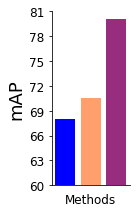

In [9]:

# AP10k results


import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MultipleLocator,MaxNLocator

# Data

df = pd.read_csv('../data/Figure2/results/ap10k.csv')

df = df.iloc[:, 1:]

df.columns = ['method', 'pretrain_model', 'training_ratio', 'shuffle', 'mAP',  'rmse']

data_labels = ['SuperAnimal_HRNetw32 zeroshot', 'ImageNet_HRNetw32_transfer_learning',  'SuperAnimal_HRNetw32_memory_replay']


superanimal_zeroshot_mAP = df[(df['method'] == 'zeroshot') &
                  (df['pretrain_model'] == 'SuperAnimal') &
                  (df['training_ratio'] == 1.0)]['mAP']



imagenet_transfer_learning_mAP = df[(df['method'] == 'transfer-learning') &
                  (df['pretrain_model'] == 'ImageNet') &
                  (df['training_ratio'] == 1.0)]['mAP']



superanimal_finetune_mAP = df[(df['method'] == 'memory-replay') &
                  (df['pretrain_model'] == 'SuperAnimal') &
                  (df['training_ratio'] == 1.0)]['mAP']


data_values = [superanimal_zeroshot_mAP * 100,
               imagenet_transfer_learning_mAP * 100, 
               superanimal_finetune_mAP * 100
              ]


# Custom colors 
colors = ['#0000FF', '#FE9F6D', '#982D80']

fig, ax1 = plt.subplots(
    ncols=1,
    tight_layout=True,
    figsize=(2, 3),
    sharex=True,
    sharey=True,
)


# Create a bar plot with labels and colors
for i, (label, value) in enumerate(zip(data_labels, data_values)):
    ax1.bar(label, value, color=colors[i], label=label)

# Add labels and title
ax1.set_xlabel('Methods', fontsize=12)
ax1.set_ylabel('mAP', fontsize=18)
#ax1.set_title('AP-10K dataset')

#ax1.legend(loc='upper left',bbox_to_anchor=(1, 1))
ax1.set_xticks([])
ax1.tick_params(axis='both', which='major', labelsize=12)
plt.tight_layout()
ax1.set_ylim(60, 81)
ax1.yaxis.set_major_locator(MaxNLocator(integer=True))

sns.despine(top=True, right=True, ax=ax1)


plt.savefig('AP10K_barplot.png', dpi = 600, transparent = True)

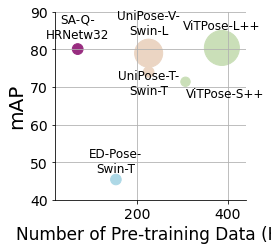

In [24]:
import matplotlib.pyplot as plt


plt.rcParams['axes.labelsize'] = 17  # for x and y labels
plt.rcParams['xtick.labelsize'] = 17 # for x axis tick labels
plt.rcParams['ytick.labelsize'] = 17 # for y axis tick labels
plt.rcParams['axes.titlesize'] = 17

# Your data
training_data = [ 226, 154, 307, 70, 387, 226]
performance = [ 74, 45.4, 71.4, 80.1, 80.4, 79]
parameter_size = [ 28, 28, 22,29, 307, 197]


colors = [ '#EBD5C3', '#ADD8E6', '#CADFB8', '#982D80', '#CADFB8', '#EBD5C3']

   

model_names = [
               "UniPose-T-\nSwin-T",
               "ED-Pose-\nSwin-T",                
               "ViTPose-S++",
               "SA-Q-\nHRNetw32",
               "ViTPose-L++",
               "UniPose-V-\nSwin-L"]

# Normalize parameter size for dot sizes in scatter plot
dot_sizes = [size * 4 for size in parameter_size]  # Adjusted scaling factor for visibility

# Create scatter plot
fig, ax = plt.subplots(figsize=(4, 4))
ax.scatter(training_data, performance, s=dot_sizes, color=colors)

offsets = [-6, 2, -4, 3, 5, 5]


for i, txt in enumerate(model_names):
    if model_names[i] == 'ViTPose-S++':
        ha = 'left'
    else:
        ha = 'center'
    ax.text(training_data[i], performance[i] + offsets[i], txt, 
            fontsize=12, ha = ha)

# Add titles and labels
#ax.set_title("Models performance after fine-tuning on AP-10K")
ax.set_xlabel('Number of Pre-training Data (K)')
ax.set_ylabel('mAP')


# Remove top and right spines
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

ax.tick_params(axis='both', which='major', labelsize=14)
plt.tight_layout()

ax.set_xlim(20,440)
ax.set_ylim(40, 90)
plt.ylabel("mAP", fontsize=20)
ax.grid()

plt.savefig('AP10k_benchmark.png', dpi = 600, transparent = True)
